## Submission file 7. Updated Date: May 3, 2020. Model: Prophet v5 with lag features median and max

## Fetch Data

In [1]:
# Import modules
# Read data
import os
import sys
import pickle

# Dataframes
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pandas import concat
# display and formatting
import warnings
warnings.filterwarnings('ignore')
pd.options.display.float_format = '{:.2f}'.format
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)


# Stats
from statsmodels.tsa.api import ExponentialSmoothing, SimpleExpSmoothing, Holt
from scipy.optimize import curve_fit
import numpy.polynomial.polynomial as poly

# Config
folder = './data/'
file = 'train_6BJx641.csv'


def _ReadCsv_pd(datafolder, file):
    """Read CSV file from remote path.
    Returns:
      The contents of CSV file.
    Raises:
      ValueError: Unable to read file
    """
    try:
        df = pd.read_csv(os.path.join(datafolder, file))
        print(file, ": Read csv to dataframe sucessfully")
        print("Shape of dataframe", df.shape, "Memory Usage", sys.getsizeof(df))
    except Exception as e:
        raise type(e)(e)
        exit()
    return(df)

df = _ReadCsv_pd(folder, file)
df_copy = df.copy()

def __GetTimeSeriesCount(df, col_name):
    try:
        print(pd.concat(g for _, g in df.groupby() if len(g) > 1))
        
    except:
        print("Dataframe is single timeseries")
    return()

__GetTimeSeriesCount(df,"datetime")

df.head()

train_6BJx641.csv : Read csv to dataframe sucessfully
Shape of dataframe (26496, 8) Memory Usage 5034400
Dataframe is single timeseries


,ID,datetime,temperature,var1,pressure,windspeed,var2,electricity_consumption
0,0,2013-07-01 00:00:00,-11.40,-17.10,1003.00,571.91,A,216.00
1,1,2013-07-01 01:00:00,-12.10,-19.30,996.00,575.04,A,210.00
2,2,2013-07-01 02:00:00,-12.90,-20.00,1000.00,578.43,A,225.00
3,3,2013-07-01 03:00:00,-11.40,-17.10,995.00,582.58,A,216.00
4,4,2013-07-01 04:00:00,-11.40,-19.30,1005.00,586.60,A,222.00


## Pre-Process Data

In [2]:
def __GetIntCols(df, collist):
    for col in collist:
        df[col] = df[col].str.extract('(\d+)').astype(float)
    return(df)

def get_prop_missing_values(df):
    print("Null info in data: ", df.isna().any().sum())
    #prop_missing = round((df[df.columns[:]].isnull().sum()/df[df.columns[:]].count())*100,4)
    prop_missing = round((df.isnull().sum()/len(df))*100,2)
    print("These are the missing values proportions in each column")
    print(prop_missing)
    return()


def __SetColumnTypes(df, change_to_int_list = ['col1']):
    cols = df.columns
    try:
        df = __GetIntCols(df, change_to_int_list)
    except:
        pass
    # Check for any null values in the data
    print("% Missing data in each column \n",get_prop_missing_values(df))
    return(df, cols)


# For this particular dataframe
df['datetime'] = pd.to_datetime(df['datetime'])
clean_df, cols = __SetColumnTypes(df)

# Get list of column by types
num_cols = df.select_dtypes(include=np.number).columns.tolist()
cat_cols = list(set(cols) - set(num_cols))
cat_cols.remove('datetime')
print(cat_cols)

Null info in data: 0
These are the missing values proportions in each column
ID                        0.00
datetime                  0.00
temperature               0.00
var1                      0.00
pressure                  0.00
windspeed                 0.00
var2                      0.00
electricity_consumption   0.00
dtype: float64
% Missing data in each column 
 ()
['var2']


## Exploring the Data

Distribution for
var2
A    25239
C     1040
B      217
Name: var2, dtype: int64


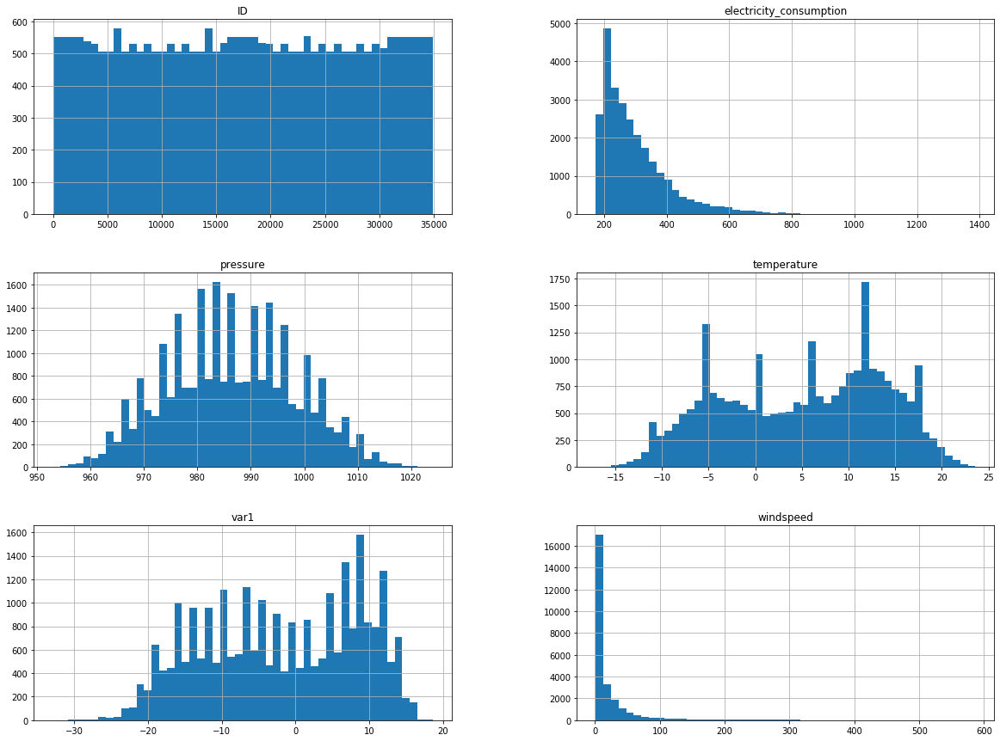

,ID,temperature,var1,pressure,windspeed,electricity_consumption
count,26496.00,26496.00,26496.00,26496.00,26496.00,26496.00
mean,17455.50,5.10,-1.92,986.45,23.96,298.36
std,10122.87,8.68,10.42,12.00,48.28,108.02
min,0.00,-17.10,-32.90,953.00,1.07,174.00
25%,8717.75,-2.90,-10.70,978.00,3.15,219.00
50%,17435.50,6.40,-1.40,986.00,6.54,267.00
75%,26177.25,12.10,7.90,995.00,22.26,342.00
max,34895.00,23.60,18.60,1024.00,586.60,1386.00


In [3]:
def __ExploringDataframe(df, cat_list):
    for col in cat_list:
        print("Distribution for")
        print(col)
        print(df[col].value_counts())

    # Above data as plots
    df.hist(bins=50, figsize=(20,15))
    plt.show()
    return()

__ExploringDataframe(clean_df, cat_cols)
# Lets look at the rest of the fields - we can check out the numeric data using describe method
clean_df.describe()

## Split Train Test and Explore


Min date train main 2013-07-01 00:00:00 Max date train main 2016-09-10 03:00:00
Min date test main 2016-09-10 04:00:00 Max date test main 2017-06-23 23:00:00
Length of train 21196 Length of test 5300
Plot 1: Simple scatter plot of feature1 and feature2
Plot 2: Scatter plot of feature1 and feature2 with density feature
Plot 3: Scatter plot with df; target as color
Corr with original set of features
electricity_consumption    1.00
var1                       0.14
ID                         0.05
pressure                  -0.01
temperature               -0.11
windspeed                 -0.25
Name: electricity_consumption, dtype: float64
Corr with addition of new features
electricity_consumption      1.00
var1                         0.14
windspeed_per_var1           0.07
ID                           0.05
pressure                    -0.01
pressure_per_temperature    -0.06
temperature                 -0.11
temperature_per_windspeed   -0.11
windspeed                   -0.25
Name: electricity_co

,ID,ds,temperature,var1,pressure,windspeed,var2,electricity_consumption
0,0,2013-07-01 00:00:00,-11.40,-17.10,1003.00,571.91,A,216.00
1,1,2013-07-01 01:00:00,-12.10,-19.30,996.00,575.04,A,210.00
2,2,2013-07-01 02:00:00,-12.90,-20.00,1000.00,578.43,A,225.00


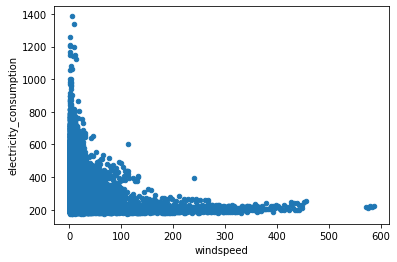

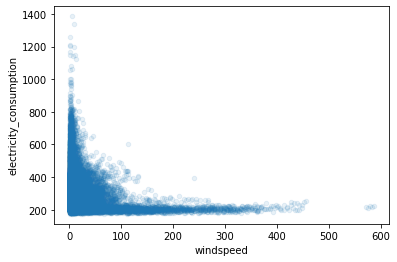

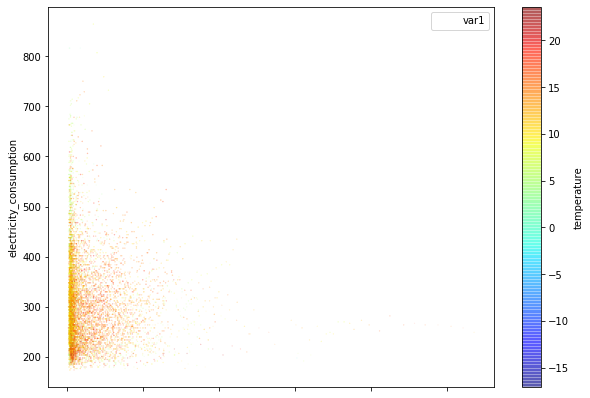

In [4]:
# Helper functions
# Split dataframe
def __SplitTrainTest(X, prop = 0.95):
    '''Takes in the dataframe and proprtion of train size and returns the train and test sets'''
    X.sort_values(by='ds', ascending=True, inplace = True)
    train_size = int(len(X) * prop)
    train, test = X[0:train_size], X[train_size:len(X)]
    print("Min date train main", train.ds.min(), "Max date train main", train.ds.max())
    print("Min date test main", test.ds.min(), "Max date test main", test.ds.max())
    print("Length of train", len(train), "Length of test", len(test))
    return(train, test)

clean_df.rename(columns={'datetime': 'ds'}, inplace=True)
train_df, test_df = __SplitTrainTest(clean_df, prop = 0.80)

# Step 5: Put the test set aside



def __SimpleScatterPlots(df, feature1, feature2, feature3, target):
    try:
        print("Plot 1: Simple scatter plot of feature1 and feature2")
        df.plot(kind='scatter', x=feature1, y=feature2)

        # Using density to see which areas are densly populated
        print("Plot 2: Scatter plot of feature1 and feature2 with density feature")
        df.plot(kind='scatter', x=feature1, y=feature2, alpha = 0.1)

        # Adding more variable features to map color of circle (price) and size of circle (population)

        print("Plot 3: Scatter plot with df; target as color")
        df.plot(kind='scatter', x=feature1, y=feature2, alpha = 0.4,
                    s= df[feature3]/100, label= feature3, figsize = (10,7),
                    c= target, cmap = plt.get_cmap("jet"), colorbar= True
                    )
        plt.legend()
    except:
        pass
    return()

__SimpleScatterPlots(train_df, 'windspeed', 'electricity_consumption', 'var1', 'temperature')

# Correlation with target variable
corr_matrix = train_df.corr()
print("Corr with original set of features")
print(corr_matrix["electricity_consumption"].sort_values(ascending=False))

train_df["windspeed_per_var1"] = train_df["windspeed"]/train_df["var1"]
train_df["pressure_per_temperature"] = train_df["pressure"]/train_df["temperature"]
train_df["temperature_per_windspeed"] = train_df["temperature"]/train_df["windspeed"]

# Correlation with target variable
corr_matrix = train_df.corr()
print("Corr with addition of new features")
print(corr_matrix["electricity_consumption"].sort_values(ascending=False))

print("Dropping the new features at this point")
drop_cols = ['windspeed_per_var1', 'pressure_per_temperature', 'temperature_per_windspeed']
train_df.drop(drop_cols, axis = 1, inplace = True)
train_df.head(3)

In [5]:

def mean_absolute_percentage_error(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


## Prepare Model Data

In [6]:
# Get a clean train dataset with separate label
 

def __Transform(dfx):
    try:
        model_labels = dfx["electricity_consumption"].copy()
        dfx = dfx.drop(["electricity_consumption"], axis = 1)
    except:
        pass
    model_id = dfx["ID"].copy()
    model_ds = dfx["ds"].copy()
    model_df = dfx.drop(["ID","ds"], axis = 1)

    # Convert categorical variables to numeric - one hot encoder

    from sklearn.preprocessing import OneHotEncoder


    cat_encoder = OneHotEncoder()
    model_cat = model_df[cat_cols]
    model_cat_1hot = cat_encoder.fit_transform(model_cat)
    # model_cat_1hot.toarray()

#     print(cat_encoder.categories_)


    # Scale numeric
    from sklearn.pipeline import Pipeline
    from sklearn.preprocessing import StandardScaler

    num_pipeline = Pipeline([
        ('std_scaler', StandardScaler())
    ])


    model_num = model_df.drop(cat_cols, axis = 1)
    model_num_tr = num_pipeline.fit_transform(model_num)


    from sklearn.compose import ColumnTransformer

    num_attribs = list(model_num)
    cat_attribs = cat_cols

    full_pipeline = ColumnTransformer([
        ('num', num_pipeline, num_attribs),
        ('cat', OneHotEncoder(), cat_attribs)
    ])


    model_prepared = full_pipeline.fit_transform(model_df)

    trans_df = pd.DataFrame(
        model_prepared,
        columns=['temperature','var1','pressure','windspeed','A','B','C'])


    # trans_df["ID"] = model_id
    trans_df["ds"] = list(model_ds)
    def __SetDsIndex(df):
        df['ds'] = pd.to_datetime(df['ds'])
        df = df.set_index('ds')
        df['ds'] = pd.to_datetime(df.index)
        return(df)
    trans_df = __SetDsIndex(trans_df)
    trans_df['ID'] = list(model_id)
    try:
        trans_df["electricity_consumption"] = list(model_labels)
        trans_df = trans_df[['ID' ,'ds','temperature', 'var1','pressure','windspeed','A','B','C','electricity_consumption']]
        trans_df.rename(columns={'electricity_consumption': 'y'}, inplace=True)
    except:
        trans_df = trans_df[['ID' ,'ds','temperature', 'var1','pressure','windspeed','A','B','C']]
    def date_features(df,date_col):
        '''Returns dataframe with date features on date column given'''
        df['ds'] = pd.to_datetime(df[date_col])
        df['d_hour'] = df.ds.dt.hour
        df['d_month'] = df.ds.dt.month
        df['d_dayofyear'] = df.ds.dt.dayofyear
        df['d_weeknum'] = df.ds.dt.week
        df['d_weekday'] = df.ds.dt.weekday
        df['d_weekend'] = np.where(df['d_weekday']<5,0,1)
        return(df)
    trans_df = date_features(trans_df,'ds')
    print("Returned transformed df")
    return(trans_df)


In [7]:
tr_df = __Transform(train_df)
ts_df = __Transform(test_df)

Returned transformed df
Returned transformed df


In [8]:
def __GenerateLagIndVarFeatures(df):
    # Lag features
    df['var1_lag1'] = df['var1'].shift(1)
    df['var1_lag1'] = df['var1_lag1'].fillna(df['var1'])
    df['var1_lag2'] = df['var1'].shift(2)
    df['var1_lag2'] = df['var1_lag2'].fillna(df['var1'])
    df['var1_lag3'] = df['var1'].shift(3)
    df['var1_lag3'] = df['var1_lag3'].fillna(df['var1'])

    window = df['var1'].rolling(window=1)
    means = window.mean()
    df['var1_window_1'] = means
    df['var1_window_1'] = df['var1_window_1'].fillna(df['var1'])


    window = df['var1'].rolling(window=2)
    means = window.mean()
    df['var1_window_2'] = means
    df['var1_window_2'] = df['var1_window_2'].fillna(df['var1_window_1'])

    window = df['var1'].rolling(window=3)
    means = window.mean()
    df['var1_window_3'] = means
    df['var1_window_3'] = df['var1_window_3'].fillna(df['var1_window_2'])

    return(df)

def __GetPolyFeature(train_df, test_df, order = 2):

    dfx = np.array(train_df['ID'])
    dfy = np.array(train_df['y'])
    x_new = np.array(test_df['ID'])

    coefs = poly.polyfit(dfx, dfy, order)
    tr_ffit = poly.polyval(dfx, coefs)
#     plt.plot(dfx, dfy, label = 'train_df')
#     plt.plot(dfx, tr_ffit, label = 'Predict')
    error = mean_absolute_percentage_error(dfy, tr_ffit)
    print(error)


    coefs = poly.polyfit(dfx, dfy, 2)
    ts_ffit = poly.polyval(x_new, coefs)
    ts_ffit = list(ts_ffit)
    return(tr_ffit, ts_ffit)

In [9]:
# Adding all features

tr_df = __GenerateLagIndVarFeatures(tr_df)
ts_df = __GenerateLagIndVarFeatures(ts_df)

tr_curve, ts_curve = __GetPolyFeature(tr_df, ts_df, 5)

tr_df['curve5'] = tr_curve
ts_df['curve5'] = ts_curve

tr_curve, ts_curve = __GetPolyFeature(tr_df, ts_df, 2)
tr_df['curve2'] = tr_curve
ts_df['curve2'] = ts_curve

# Mean as a feature
mean_val = tr_df['y'].mean()
tr_df['mean_y'] = mean_val
ts_df['mean_y'] = mean_val

max_val = tr_df['y'].max()
tr_df['max_y'] = max_val
ts_df['max_y'] = max_val

med_val = tr_df['y'].median()
tr_df['med_y'] = med_val
ts_df['med_y'] = med_val

27.37083034727098
27.586202533971083


# Prophet

In [11]:
# !conda activate stanenv

In [10]:
from fbprophet import Prophet

In [11]:
regressors_ls = ['temperature','var1','windspeed','A','B','C','d_hour','d_month', 'd_dayofyear','d_weeknum','d_weekday','d_weekend', 'var1_lag1', 'var1_lag2', 'var1_lag3', 'var1_window_1', 'var1_window_2', 'var1_window_3', 'curve5', 'curve2', 'mean_y','max_y', 'med_y']



In [12]:
future_df = ts_df.copy()

m1 = Prophet(daily_seasonality=True)
# m1.add_seasonality(name='quarter',period=365.25/4,fourier_order=5)
# m1.add_seasonality(name='weekly',period=7,fourier_order=20)
# m1.add_seasonality(name='monthly',period=30.5,fourier_order=20)
# m1.add_seasonality(name='yearly',period=365.25,fourier_order=20)
# m1.add_seasonality(name='weekly 1',period=5,fourier_order=5)
# m1.add_seasonality(name='monthly 2',period=14,fourier_order=5)


#add regressors
for feature in regressors_ls:
    m1.add_regressor(feature)
    
m1.fit(tr_df)


forecast1 = m1.predict(future_df)
print("Model trained")


Model trained


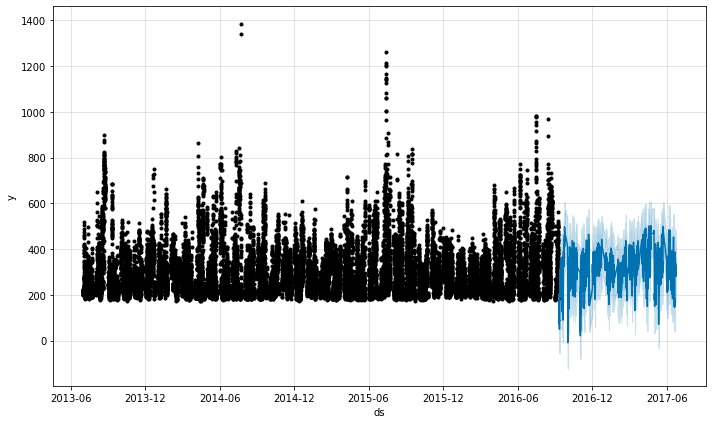

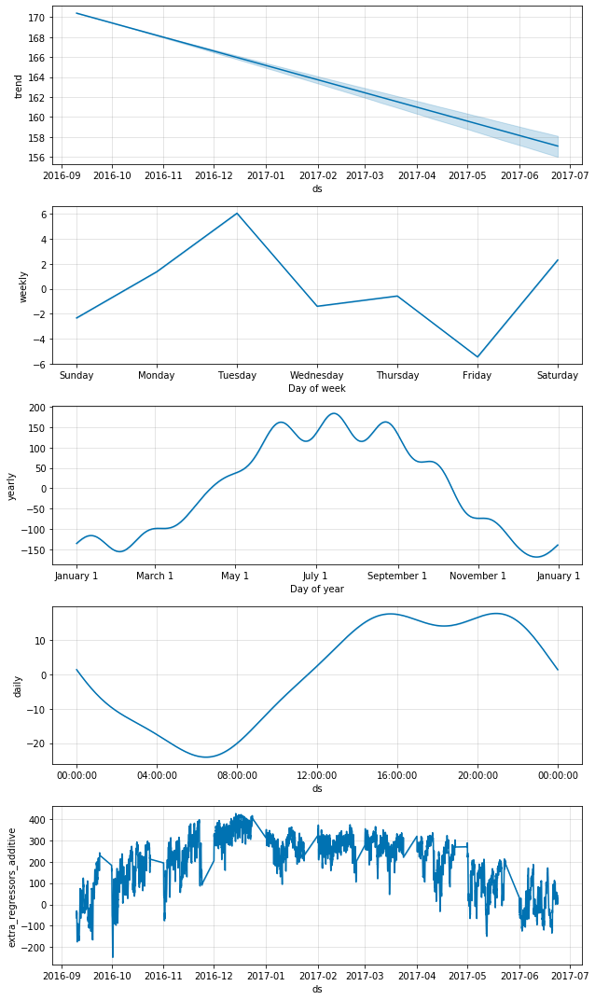

In [13]:
fig1 = m1.plot(forecast1)
fig2 = m1.plot_components(forecast1)

In [14]:




actual = pd.Series(ts_df['y'])
actual = actual.tolist()

predictions = forecast1['yhat']
forecast1['actual'] = actual

min_val = min(actual)

forecast1['yhat'] = np.where(forecast1['yhat'] < 0, min_val, forecast1['yhat'])

mape = mean_absolute_percentage_error(actual, forecast1['yhat'])
mape # 20.66 (for previous model)
#20.8225739190217
# 20.84

26.858324923471415

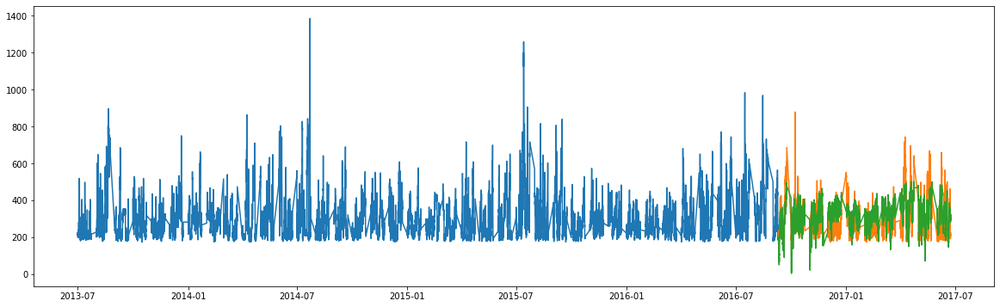

In [15]:
# Plots

fig = plt.figure(facecolor='w', figsize=(20, 6))
plt.plot(tr_df.ds, tr_df.y,  label='Train')
plt.plot(ts_df.ds, ts_df.y,  label='Test')
plt.plot(ts_df.ds, forecast1['yhat'],  label='Predicted')
plt.show()

## Inference Service

In [16]:
test = _ReadCsv_pd(folder, 'test_pavJagI.csv')
print("Dates to predict for test", test.datetime.min(), test.datetime.max())
print("Dates to predict for test_df", test.datetime.min(), "last", test.datetime.max(), "Len", len(test))
test.rename(columns={'datetime': 'ds'}, inplace=True)
test.head(3)

test_pavJagI.csv : Read csv to dataframe sucessfully
Shape of dataframe (8568, 7) Memory Usage 1559536
Dates to predict for test 2013-07-24 00:00:00 2017-06-30 23:00:00
Dates to predict for test_df 2013-07-24 00:00:00 last 2017-06-30 23:00:00 Len 8568


,ID,ds,temperature,var1,pressure,windspeed,var2
0,552,2013-07-24 00:00:00,-10.00,-16.40,1011.00,263.28,A
1,553,2013-07-24 01:00:00,-10.00,-20.70,1011.00,267.18,A
2,554,2013-07-24 02:00:00,-10.70,-17.10,1003.00,269.56,A


In [17]:
full_train_df = __Transform(clean_df)
pred_df = __Transform(test)

Returned transformed df
Returned transformed df


In [18]:
# Adding all features

full_train_df = __GenerateLagIndVarFeatures(full_train_df)
pred_df = __GenerateLagIndVarFeatures(pred_df)

tr_curve, ts_curve = __GetPolyFeature(full_train_df, pred_df, 5)

full_train_df['curve5'] = tr_curve
pred_df['curve5'] = ts_curve

tr_curve, ts_curve = __GetPolyFeature(full_train_df, pred_df, 2)
full_train_df['curve2'] = tr_curve
pred_df['curve2'] = ts_curve

# Mean as a feature
mean_val = full_train_df['y'].mean()
full_train_df['mean_y'] = mean_val
pred_df['mean_y'] = mean_val

max_val = full_train_df['y'].max()
full_train_df['max_y'] = max_val
pred_df['max_y'] = max_val

med_val = full_train_df['y'].median()
full_train_df['med_y'] = med_val
pred_df['med_y'] = med_val

26.898682450925833
26.96184452583623


In [22]:
# regressors_ls = ['temperature','var1','windspeed','A','B','C','d_hour','d_month', 'd_dayofyear','d_weeknum','d_weekday','d_weekend']
future_df = pred_df.copy()

m1 = Prophet(daily_seasonality=True)
m1.add_seasonality(name='quarter',period=365.25/4,fourier_order=5)
#add regressors
for feature in regressors_ls:
    m1.add_regressor(feature)
    
m1.fit(full_train_df)


forecast1 = m1.predict(future_df)
print("Model trained")


Model trained


In [23]:
predicted = forecast1['yhat'].copy()
predicted = predicted.tolist()
forecast1 = test.copy()
x = max(clean_df.index)+test.index
forecast1.index = x
forecast1['electricity_consumption'] = predicted
forecast1.head()

min_val = full_train_df['y'].min()

forecast1['electricity_consumption'] = np.where(forecast1['electricity_consumption'] < 0, min_val, forecast1['electricity_consumption'])




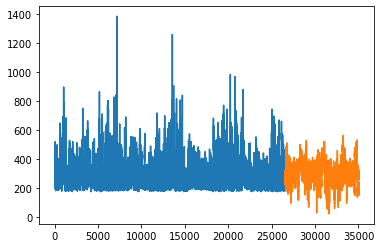

In [24]:


# #plot the predictions for validation set
plt.plot(clean_df.electricity_consumption, label='Train')
plt.plot(forecast1.electricity_consumption, label='Prediction')
plt.show()

In [25]:


submission = forecast1[['ID', 'electricity_consumption']]
submission.head()

output_directory = "./submissions/"
submission.to_csv(output_directory + "electricity_consumption_prediction.csv", index=False)